In [1]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 

## DATA LOADING AND CLEANING 

In [2]:
df=pd.read_csv("Taxi_Trips_-_2024_20240408.csv")

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 865247 entries, 0 to 865246
Data columns (total 23 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   Trip ID                     865247 non-null  object 
 1   Taxi ID                     865246 non-null  object 
 2   Trip Start Timestamp        865247 non-null  object 
 3   Trip End Timestamp          865239 non-null  object 
 4   Trip Seconds                865078 non-null  float64
 5   Trip Miles                  865241 non-null  float64
 6   Pickup Census Tract         327251 non-null  float64
 7   Dropoff Census Tract        313854 non-null  float64
 8   Pickup Community Area       842052 non-null  float64
 9   Dropoff Community Area      781394 non-null  float64
 10  Fare                        863202 non-null  float64
 11  Tips                        863202 non-null  float64
 12  Tolls                       863202 non-null  float64
 13  Extras        

In [4]:
df.head()

,Trip ID,Taxi ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,...,Extras,Trip Total,Payment Type,Company,Pickup Centroid Latitude,Pickup Centroid Longitude,Pickup Centroid Location,Dropoff Centroid Latitude,Dropoff Centroid Longitude,Dropoff Centroid Location
0,0287f53fedcde6b0af9aab9e32cbd2cadb337eaa,e54db25f18193a08f1f5754515e8c338480e04fb938ed3...,03/01/2024 12:00:00 AM,03/01/2024 12:00:00 AM,15.0,0.09,NaN,NaN,8.0,8.0,...,35.0,38.75,Credit Card,City Service,41.899602,-87.633308,POINT (-87.6333080367 41.899602111),41.899602,-87.633308,POINT (-87.6333080367 41.899602111)
1,1f0034299b914fd7b45002568576a353c83acb2f,4a263f78f56815be4acd38658af8fc1824ce4e15f7ec81...,03/01/2024 12:00:00 AM,03/01/2024 12:15:00 AM,900.0,3.00,NaN,NaN,24.0,8.0,...,0.0,12.00,Cash,Taxi Affiliation Services,41.901207,-87.676356,POINT (-87.6763559892 41.9012069941),41.899602,-87.633308,POINT (-87.6333080367 41.899602111)
2,01a0b77b722a0b91f45cb4fc90b3e64f76fd0681,4f1e94982e6851725add382f7981d64006ae7c38f3664f...,03/01/2024 12:00:00 AM,03/01/2024 12:00:00 AM,711.0,5.84,NaN,NaN,56.0,NaN,...,5.0,26.70,Credit Card,City Service,41.792592,-87.769615,POINT (-87.7696154528 41.7925923603),NaN,NaN,NaN
3,14aff2071ac81c6450a8f8b0e1534497da900197,de8e8659ceb9eb0da842a46b60c0a5207098ac69fc23ab...,03/01/2024 12:00:00 AM,03/01/2024 12:30:00 AM,1770.0,13.36,NaN,NaN,76.0,3.0,...,4.0,47.10,Credit Card,Sun Taxi,41.980264,-87.913625,POINT (-87.913624596 41.9802643146),41.965812,-87.655879,POINT (-87.6558787862 41.96581197)
4,16d3a633e2f380cee4a7fa4677db163b6e91255d,d79d3e19a1d5f6cb0cd4449d5579412262a2f1b182799d...,03/01/2024 12:00:00 AM,03/01/2024 12:15:00 AM,849.0,6.13,NaN,NaN,8.0,3.0,...,0.0,22.82,Mobile,5 Star Taxi,41.899602,-87.633308,POINT (-87.6333080367 41.899602111),41.965812,-87.655879,POINT (-87.6558787862 41.96581197)


In [5]:
df['Company'].value_counts()

Company
Flash Cab                               196924
Taxi Affiliation Services               163321
Sun Taxi                                 91445
Taxicab Insurance Agency Llc             90628
City Service                             79740
Chicago Independents                     50675
5 Star Taxi                              38704
Globe Taxi                               31753
Blue Ribbon Taxi Association             29769
Medallion Leasin                         25128
Taxicab Insurance Agency, LLC            15079
Choice Taxi Association                   9853
Chicago City Taxi Association             9599
Choice Taxi Association Inc               7761
U Taxicab                                 6450
Top Cab                                   2892
Tac - Yellow Cab Association              2806
Koam Taxi Association                     2481
Patriot Taxi Dba Peace Taxi Associat      1547
Chicago Taxicab                           1514
Taxi Affiliation Services Llc - Yell      1134
312 M

In [6]:
df_num = df.select_dtypes(include=['number'])


In [7]:
df_num.corr()

,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,Fare,Tips,Tolls,Extras,Trip Total,Pickup Centroid Latitude,Pickup Centroid Longitude,Dropoff Centroid Latitude,Dropoff Centroid Longitude
Trip Seconds,1.000000,0.369949,0.319637,0.052653,0.231459,0.078764,0.350709,0.173847,0.000069,0.035883,0.236098,0.111495,-0.256047,0.024689,-0.111985
Trip Miles,0.369949,1.000000,0.514837,0.070324,0.460981,0.129998,0.804618,0.381611,-0.000165,0.095533,0.549870,0.194971,-0.487994,-0.010575,-0.141229
Pickup Census Tract,0.319637,0.514837,1.000000,0.069113,0.878011,0.073304,0.520772,0.423644,0.001658,0.153454,0.435596,0.447322,-0.762115,0.113719,-0.137516
Dropoff Census Tract,0.052653,0.070324,0.069113,1.000000,0.078118,0.769953,0.099115,0.054383,0.001876,0.006597,0.069865,0.033471,-0.057771,0.137044,-0.532482
Pickup Community Area,0.231459,0.460981,0.878011,0.078118,1.000000,0.081193,0.366154,0.423048,0.001637,0.120416,0.320069,0.201998,-0.786959,-0.008500,-0.089361
Dropoff Community Area,0.078764,0.129998,0.073304,0.769953,0.081193,1.000000,0.126954,-0.015979,0.001185,-0.003941,0.072558,-0.189350,0.059673,-0.299892,-0.436891
Fare,0.350709,0.804618,0.520772,0.099115,0.366154,0.126954,1.000000,0.325108,0.000297,0.071930,0.680808,0.141928,-0.384433,-0.010604,-0.136726
Tips,0.173847,0.381611,0.423644,0.054383,0.423048,-0.015979,0.325108,1.000000,0.000445,0.121088,0.360250,0.321169,-0.516858,0.160991,-0.126931
Tolls,0.000069,-0.000165,0.001658,0.001876,0.001637,0.001185,0.000297,0.000445,1.000000,0.659111,0.626948,-0.001157,-0.000589,-0.003469,0.001669
Extras,0.035883,0.095533,0.153454,0.006597,0.120416,-0.003941,0.071930,0.121088,0.659111,1.000000,0.736290,0.077711,-0.141839,0.015964,-0.014835


In [8]:
df['Payment Type'].value_counts()

Payment Type
Credit Card    324125
Cash           253722
Mobile         127520
Prcard         112964
Unknown         45868
No Charge         738
Dispute           310
Name: count, dtype: int64

In [9]:
df[df['Payment Type']=="Dispute"].head()

,Trip ID,Taxi ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,...,Extras,Trip Total,Payment Type,Company,Pickup Centroid Latitude,Pickup Centroid Longitude,Pickup Centroid Location,Dropoff Centroid Latitude,Dropoff Centroid Longitude,Dropoff Centroid Location
1284,4223f7e104a5f8ce191b25f65d06ac6aae99e55f,f8b84760a5c303b6f781d9864346b47bc9d11271782082...,02/29/2024 09:30:00 PM,02/29/2024 10:15:00 PM,2640.0,13.1,NaN,NaN,NaN,NaN,...,0.0,37.50,Dispute,Chicago City Taxi Association,NaN,NaN,NaN,NaN,NaN,NaN
1402,c37f1dfcc33f226a232ba871c1a0e59eff3f1af4,9e402f28d4da35014d6f3171cf85336476cebfccf79048...,02/29/2024 09:15:00 PM,02/29/2024 09:30:00 PM,1500.0,0.0,NaN,NaN,76.0,16.0,...,4.0,33.25,Dispute,Chicago Independents,41.980264,-87.913625,POINT (-87.913624596 41.9802643146),41.953582,-87.723452,POINT (-87.7234523905 41.9535821253)
1788,a3d2304f0537c1fa220a93aae249261f3064ca6f,c85b14c46a0a7fc5391cdfbf0a516073a276dca0cf6a98...,02/29/2024 08:45:00 PM,02/29/2024 09:00:00 PM,1020.0,5.5,NaN,NaN,76.0,NaN,...,4.0,21.00,Dispute,Chicago Independents,41.980264,-87.913625,POINT (-87.913624596 41.9802643146),NaN,NaN,NaN
2748,6600d31684464d3116aa92f47f9485760ec925de,b45a6ac97b6cb6f7a1332642e0c59f40de007e1096dfb4...,02/29/2024 08:00:00 PM,02/29/2024 08:00:00 PM,0.0,0.0,1.703198e+10,1.703198e+10,56.0,56.0,...,0.0,3.25,Dispute,"Taxicab Insurance Agency, LLC",41.785999,-87.750934,POINT (-87.7509342894 41.785998518),41.785999,-87.750934,POINT (-87.7509342894 41.785998518)
5556,96a5ae006eeb782dcfd866f1e37bef7a9e46aaee,f8b84760a5c303b6f781d9864346b47bc9d11271782082...,02/29/2024 05:45:00 PM,02/29/2024 06:45:00 PM,3120.0,13.6,NaN,NaN,NaN,NaN,...,4.0,40.75,Dispute,Chicago City Taxi Association,NaN,NaN,NaN,NaN,NaN,NaN


In [10]:
df.columns

Index(['Trip ID', 'Taxi ID', 'Trip Start Timestamp', 'Trip End Timestamp',
       'Trip Seconds', 'Trip Miles', 'Pickup Census Tract',
       'Dropoff Census Tract', 'Pickup Community Area',
       'Dropoff Community Area', 'Fare', 'Tips', 'Tolls', 'Extras',
       'Trip Total', 'Payment Type', 'Company', 'Pickup Centroid Latitude',
       'Pickup Centroid Longitude', 'Pickup Centroid Location',
       'Dropoff Centroid Latitude', 'Dropoff Centroid Longitude',
       'Dropoff Centroid  Location'],
      dtype='object')

In [11]:
df['Trip End Timestamp'].value_counts()

Trip End Timestamp
02/23/2024 07:00:00 PM    444
02/23/2024 06:45:00 PM    423
02/23/2024 05:30:00 PM    413
02/22/2024 06:15:00 PM    412
02/23/2024 07:15:00 PM    412
                         ... 
03/01/2024 06:15:00 AM      1
03/01/2024 07:30:00 AM      1
03/01/2024 05:45:00 PM      1
03/01/2024 02:30:00 PM      1
03/02/2024 10:15:00 AM      1
Name: count, Length: 5771, dtype: int64

In [12]:
df.nunique()


Trip ID                       865247
Taxi ID                         2688
Trip Start Timestamp            5761
Trip End Timestamp              5771
Trip Seconds                    7127
Trip Miles                      4803
Pickup Census Tract              319
Dropoff Census Tract             452
Pickup Community Area             77
Dropoff Community Area            77
Fare                            5430
Tips                            2452
Tolls                            176
Extras                          1288
Trip Total                      9252
Payment Type                       7
Company                           37
Pickup Centroid Latitude         356
Pickup Centroid Longitude        356
Pickup Centroid Location         357
Dropoff Centroid Latitude        440
Dropoff Centroid Longitude       440
Dropoff Centroid  Location       441
dtype: int64

In [13]:
df['Trip Start Timestamp'] = pd.to_datetime(df['Trip Start Timestamp'])

# Extract features
df['start_hour'] = df['Trip Start Timestamp'].dt.hour
df['start_day_of_week'] = df['Trip Start Timestamp'].dt.dayofweek  # 0=Monday
df['start_month'] = df['Trip Start Timestamp'].dt.month
df['start_is_weekend'] = df['start_day_of_week'].isin([5,6]).astype(int)


C:\Users\Ps_TecH\AppData\Local\Temp\ipykernel_22952\4229247230.py:1: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Trip Start Timestamp'] = pd.to_datetime(df['Trip Start Timestamp'])


In [14]:
df['Trip End Timestamp'] = pd.to_datetime(df['Trip End Timestamp'])

# Extract features
df['end_hour'] = df['Trip End Timestamp'].dt.hour
df['end_day_of_week'] = df['Trip End Timestamp'].dt.dayofweek  # 0=Monday
df['end_month'] = df['Trip End Timestamp'].dt.month
df['end_is_weekend'] = df['end_day_of_week'].isin([5,6]).astype(int)


C:\Users\Ps_TecH\AppData\Local\Temp\ipykernel_22952\3673177307.py:1: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['Trip End Timestamp'] = pd.to_datetime(df['Trip End Timestamp'])


In [15]:
df.head(100)

,Trip ID,Taxi ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,...,Dropoff Centroid Longitude,Dropoff Centroid Location,start_hour,start_day_of_week,start_month,start_is_weekend,end_hour,end_day_of_week,end_month,end_is_weekend
0,0287f53fedcde6b0af9aab9e32cbd2cadb337eaa,e54db25f18193a08f1f5754515e8c338480e04fb938ed3...,2024-03-01 00:00:00,2024-03-01 00:00:00,15.0,0.09,NaN,NaN,8.0,8.0,...,-87.633308,POINT (-87.6333080367 41.899602111),0,4,3,0,0.0,4.0,3.0,0
1,1f0034299b914fd7b45002568576a353c83acb2f,4a263f78f56815be4acd38658af8fc1824ce4e15f7ec81...,2024-03-01 00:00:00,2024-03-01 00:15:00,900.0,3.00,NaN,NaN,24.0,8.0,...,-87.633308,POINT (-87.6333080367 41.899602111),0,4,3,0,0.0,4.0,3.0,0
2,01a0b77b722a0b91f45cb4fc90b3e64f76fd0681,4f1e94982e6851725add382f7981d64006ae7c38f3664f...,2024-03-01 00:00:00,2024-03-01 00:00:00,711.0,5.84,NaN,NaN,56.0,NaN,...,NaN,NaN,0,4,3,0,0.0,4.0,3.0,0
3,14aff2071ac81c6450a8f8b0e1534497da900197,de8e8659ceb9eb0da842a46b60c0a5207098ac69fc23ab...,2024-03-01 00:00:00,2024-03-01 00:30:00,1770.0,13.36,NaN,NaN,76.0,3.0,...,-87.655879,POINT (-87.6558787862 41.96581197),0,4,3,0,0.0,4.0,3.0,0
4,16d3a633e2f380cee4a7fa4677db163b6e91255d,d79d3e19a1d5f6cb0cd4449d5579412262a2f1b182799d...,2024-03-01 00:00:00,2024-03-01 00:15:00,849.0,6.13,NaN,NaN,8.0,3.0,...,-87.655879,POINT (-87.6558787862 41.96581197),0,4,3,0,0.0,4.0,3.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,a28b5aa3e8caf817a152d14ef0677c222ea2e8a7,b67c358162b4dbf47ca3cad892f6cf33d05d7dfe0b1397...,2024-02-29 23:45:00,2024-02-29 23:45:00,7.0,0.00,NaN,NaN,28.0,28.0,...,-87.663518,POINT (-87.6635175498 41.874005383),23,3,2,0,23.0,3.0,2.0,0
96,eb7cc4b4fccd17491a7d2c87766fde53e255b28d,b5f958b8508ba66e43f28559d6d54c66b9e7a7df9b45da...,2024-02-29 23:45:00,2024-03-01 00:00:00,575.0,2.05,NaN,NaN,8.0,24.0,...,-87.676356,POINT (-87.6763559892 41.9012069941),23,3,2,0,0.0,4.0,3.0,0
97,e03901c7378e29c51fabb8ceb456262c2bb46bc3,624e8f2a6af3b7f032d3c40d6f925f6fc5f0bf6a358ecc...,2024-02-29 23:45:00,2024-03-01 00:15:00,1320.0,16.30,NaN,NaN,76.0,8.0,...,-87.633308,POINT (-87.6333080367 41.899602111),23,3,2,0,0.0,4.0,3.0,0
98,edcebeb7f3d5d54568463f5d71f5c6cd1a2d1cd9,c8549ac4a2842a038f2a5b91ecf894ca7cb04d60558be3...,2024-02-29 23:45:00,2024-03-01 00:15:00,1443.0,9.51,NaN,NaN,76.0,NaN,...,NaN,NaN,23,3,2,0,0.0,4.0,3.0,0


In [16]:
df = df.dropna(subset=['Fare'])

In [17]:
df[df['start_hour']==5].head()

,Trip ID,Taxi ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,...,Dropoff Centroid Longitude,Dropoff Centroid Location,start_hour,start_day_of_week,start_month,start_is_weekend,end_hour,end_day_of_week,end_month,end_is_weekend
18304,b91ccfdd9e07dafaa50bd00106bed62412835146,d40dae7ea46d61abca67eb53b157fe9cf0b485cca6dce1...,2024-02-29 05:45:00,2024-02-29 06:00:00,796.0,11.34,NaN,NaN,33.0,49.0,...,-87.623367,POINT (-87.6233665115 41.7065878819),5,3,2,0,6.0,3.0,2.0,0
18305,b3ac02ca3859479dda002a038df42c9ea9143d05,44168d87a38ef5f1721ebe0587b37fa9189f9f15a49089...,2024-02-29 05:45:00,2024-02-29 06:15:00,1380.0,15.50,NaN,NaN,7.0,76.0,...,-87.913625,POINT (-87.913624596 41.9802643146),5,3,2,0,6.0,3.0,2.0,0
18306,f149f52cf8024a039c6ab350bbefc8354371f056,44450ce5d7c93afb896a1645acef2f8903fdc80a3b7c2c...,2024-02-29 05:45:00,2024-02-29 06:15:00,1864.0,11.23,NaN,NaN,1.0,33.0,...,-87.620335,POINT (-87.6203346241 41.8571838585),5,3,2,0,6.0,3.0,2.0,0
18307,ed3a931e95a3f567fa39826260bef0ac1c020230,62856e8ed14ce71738c14ec7cbc70d9bb570bd7048eccf...,2024-02-29 05:45:00,2024-02-29 06:00:00,970.0,8.30,NaN,NaN,8.0,31.0,...,-87.667569,POINT (-87.667569312 41.8502663663),5,3,2,0,6.0,3.0,2.0,0
18308,4617b5af11cd9fa5048489eca2caedc3efa16b18,15ddbeeb791d41c7683b885617281c0b548544f189ee36...,2024-02-29 05:45:00,2024-02-29 06:00:00,180.0,1.10,NaN,NaN,NaN,NaN,...,NaN,NaN,5,3,2,0,6.0,3.0,2.0,0


In [18]:
df = df.dropna(subset=['Trip Seconds'])


In [19]:
df = df.dropna(subset=['Trip Miles'])


In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 863104 entries, 0 to 865246
Data columns (total 31 columns):
 #   Column                      Non-Null Count   Dtype         
---  ------                      --------------   -----         
 0   Trip ID                     863104 non-null  object        
 1   Taxi ID                     863103 non-null  object        
 2   Trip Start Timestamp        863104 non-null  datetime64[ns]
 3   Trip End Timestamp          863104 non-null  datetime64[ns]
 4   Trip Seconds                863104 non-null  float64       
 5   Trip Miles                  863104 non-null  float64       
 6   Pickup Census Tract         326058 non-null  float64       
 7   Dropoff Census Tract        312719 non-null  float64       
 8   Pickup Community Area       839952 non-null  float64       
 9   Dropoff Community Area      779486 non-null  float64       
 10  Fare                        863104 non-null  float64       
 11  Tips                        863104 non-null 

In [21]:
df_num = df.select_dtypes(include=['number'])


In [22]:
df_num.corr()

,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,Fare,Tips,Tolls,Extras,...,Dropoff Centroid Latitude,Dropoff Centroid Longitude,start_hour,start_day_of_week,start_month,start_is_weekend,end_hour,end_day_of_week,end_month,end_is_weekend
Trip Seconds,1.000000,0.369424,0.319501,0.052627,0.231200,0.078712,0.350910,0.173845,0.000069,0.035883,...,0.024632,-0.111816,0.047331,0.010498,-0.000609,0.007809,0.048012,0.011225,0.000411,0.006882
Trip Miles,0.369424,1.000000,0.515256,0.070531,0.465252,0.131750,0.804253,0.385110,-0.000165,0.096367,...,-0.011221,-0.142632,0.039890,0.021702,-0.002034,0.046786,0.049646,0.021233,-0.001749,0.046118
Pickup Census Tract,0.319501,0.515256,1.000000,0.068546,0.878042,0.072673,0.520878,0.423716,0.001658,0.153456,...,0.113484,-0.136900,0.164544,-0.005171,-0.007524,0.052462,0.177860,-0.005436,-0.007444,0.052126
Dropoff Census Tract,0.052627,0.070531,0.068546,1.000000,0.077666,0.769877,0.099029,0.054444,0.001876,0.006594,...,0.137316,-0.532284,-0.146041,-0.028835,0.003183,-0.023950,-0.141524,-0.028900,0.003204,-0.024106
Pickup Community Area,0.231200,0.465252,0.878042,0.077666,1.000000,0.080909,0.415368,0.423099,0.001637,0.120414,...,-0.008648,-0.088865,0.127043,0.006162,-0.011111,0.039075,0.123940,0.005047,-0.010785,0.037750
Dropoff Community Area,0.078712,0.131750,0.072673,0.769877,0.080909,1.000000,0.145619,-0.015943,0.001186,-0.003945,...,-0.300293,-0.436247,-0.104926,-0.005445,0.004625,-0.002331,-0.096206,-0.005285,0.004602,-0.002325
Fare,0.350910,0.804253,0.520878,0.099029,0.415368,0.145619,1.000000,0.364308,0.000338,0.080540,...,-0.011023,-0.158038,0.034765,0.023976,-0.006050,0.045996,0.044324,0.023723,-0.005809,0.045488
Tips,0.173845,0.385110,0.423716,0.054444,0.423099,-0.015943,0.364308,1.000000,0.000445,0.121092,...,0.161035,-0.127025,0.090070,0.010846,-0.004716,0.023708,0.092956,0.010351,-0.004515,0.023024
Tolls,0.000069,-0.000165,0.001658,0.001876,0.001637,0.001186,0.000338,0.000445,1.000000,0.659114,...,-0.003469,0.001669,-0.000473,0.000524,-0.000284,-0.000605,-0.000548,0.000528,-0.000286,-0.000607
Extras,0.035883,0.096367,0.153456,0.006594,0.120414,-0.003945,0.080540,0.121092,0.659114,1.000000,...,0.015962,-0.014830,0.022225,0.002759,-0.003453,0.009563,0.020944,0.002521,-0.003413,0.009277


In [23]:
df.head()

,Trip ID,Taxi ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,...,Dropoff Centroid Longitude,Dropoff Centroid Location,start_hour,start_day_of_week,start_month,start_is_weekend,end_hour,end_day_of_week,end_month,end_is_weekend
0,0287f53fedcde6b0af9aab9e32cbd2cadb337eaa,e54db25f18193a08f1f5754515e8c338480e04fb938ed3...,2024-03-01,2024-03-01 00:00:00,15.0,0.09,NaN,NaN,8.0,8.0,...,-87.633308,POINT (-87.6333080367 41.899602111),0,4,3,0,0.0,4.0,3.0,0
1,1f0034299b914fd7b45002568576a353c83acb2f,4a263f78f56815be4acd38658af8fc1824ce4e15f7ec81...,2024-03-01,2024-03-01 00:15:00,900.0,3.00,NaN,NaN,24.0,8.0,...,-87.633308,POINT (-87.6333080367 41.899602111),0,4,3,0,0.0,4.0,3.0,0
2,01a0b77b722a0b91f45cb4fc90b3e64f76fd0681,4f1e94982e6851725add382f7981d64006ae7c38f3664f...,2024-03-01,2024-03-01 00:00:00,711.0,5.84,NaN,NaN,56.0,NaN,...,NaN,NaN,0,4,3,0,0.0,4.0,3.0,0
3,14aff2071ac81c6450a8f8b0e1534497da900197,de8e8659ceb9eb0da842a46b60c0a5207098ac69fc23ab...,2024-03-01,2024-03-01 00:30:00,1770.0,13.36,NaN,NaN,76.0,3.0,...,-87.655879,POINT (-87.6558787862 41.96581197),0,4,3,0,0.0,4.0,3.0,0
4,16d3a633e2f380cee4a7fa4677db163b6e91255d,d79d3e19a1d5f6cb0cd4449d5579412262a2f1b182799d...,2024-03-01,2024-03-01 00:15:00,849.0,6.13,NaN,NaN,8.0,3.0,...,-87.655879,POINT (-87.6558787862 41.96581197),0,4,3,0,0.0,4.0,3.0,0


## Visualization

In [24]:
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px


<Axes: xlabel='Fare', ylabel='Trip Miles'>

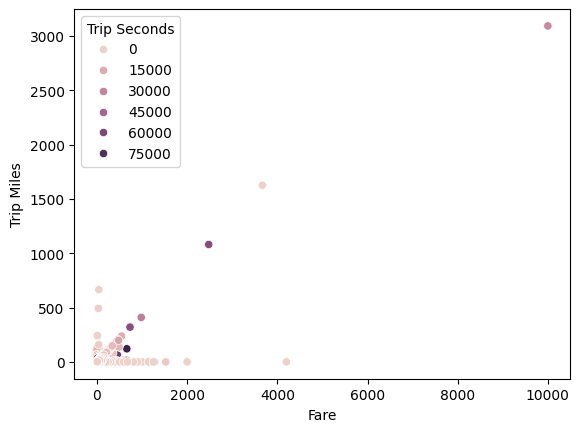

In [25]:
sns.scatterplot(x="Fare",y='Trip Miles',hue='Trip Seconds',data=df)

<Axes: xlabel='Fare', ylabel='Trip Seconds'>

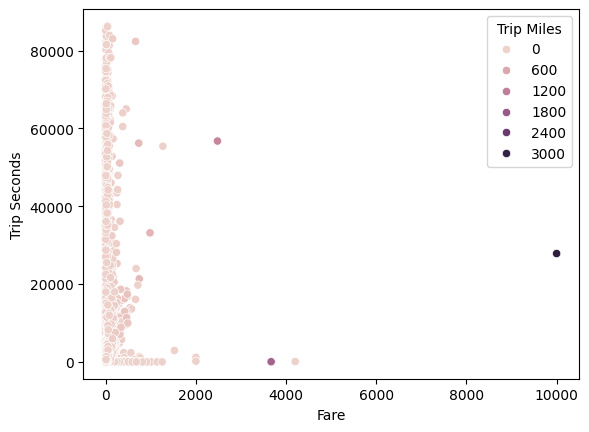

In [26]:
sns.scatterplot(x="Fare",y='Trip Seconds',hue='Trip Miles',data=df)

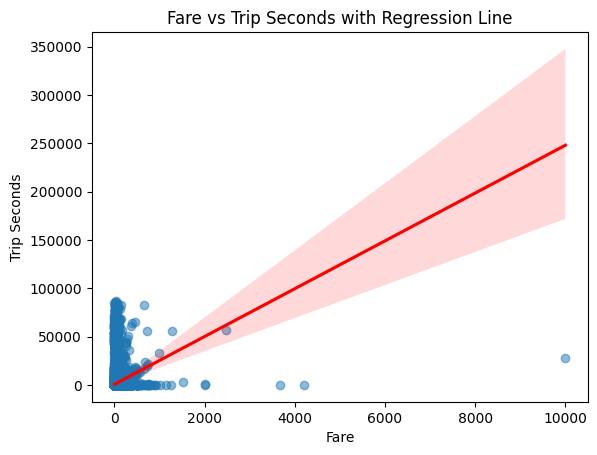

In [27]:
sns.regplot(
    x="Fare", 
    y="Trip Seconds", 
    data=df,
    scatter_kws={'alpha':0.5},   # makes scatter points lighter
    line_kws={'color':'red'}     # regression line color
)
plt.title("Fare vs Trip Seconds with Regression Line")
plt.show()

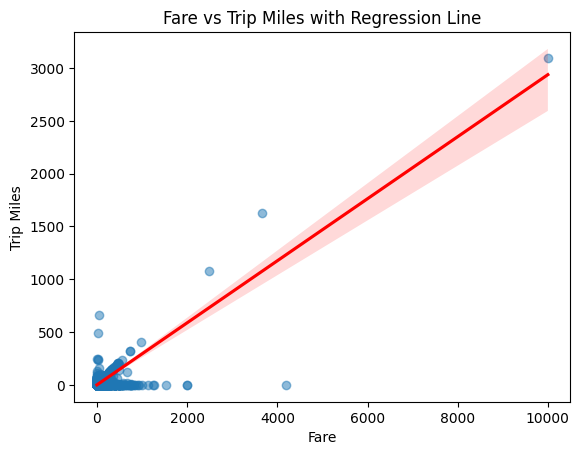

In [28]:
sns.regplot(
    x="Fare", 
    y="Trip Miles", 
    data=df,
    scatter_kws={'alpha':0.5},   # makes scatter points lighter
    line_kws={'color':'red'}     # regression line color
)
plt.title("Fare vs Trip Miles with Regression Line")
plt.show()

In [29]:


fig = px.scatter_3d(
    df, 
    x="Fare", 
    y="Trip Miles", 
    z="Trip Seconds",    # 3rd column
    # color="",  # optional 4th variable
    # size="Engagement_Score", # optional 5th
    opacity=0.5
)
fig.show()


Text(0.5, 1.0, 'Fares at Each Hour Of The Day')

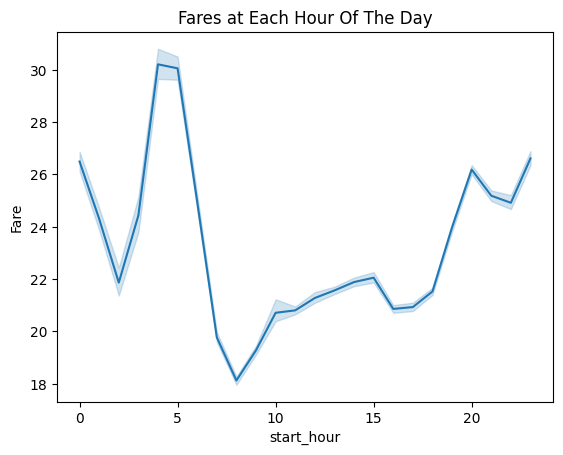

In [30]:
sns.lineplot(x='start_hour',y='Fare',data=df)
plt.title("Fares at Each Hour Of The Day")

In [31]:
df['Fare_per_mile'] = (df['Fare']) / df['Trip Miles']
# avg_speed = df.groupby('start_hour')['minutes_per_mile'].mean().reset_index()


In [32]:
df['minutes_per_mile'] = (df['Trip Seconds'] / 60) / df['Trip Miles']
avg_speed = df.groupby('start_hour')['minutes_per_mile'].mean().reset_index()


In [33]:
df['minutes_per_mile']

0         2.777778
1         5.000000
2         2.029110
3         2.208084
4         2.308320
            ...   
865242    4.943020
865243    1.879332
865244    2.923356
865245    7.432139
865246    7.248322
Name: minutes_per_mile, Length: 863104, dtype: float64

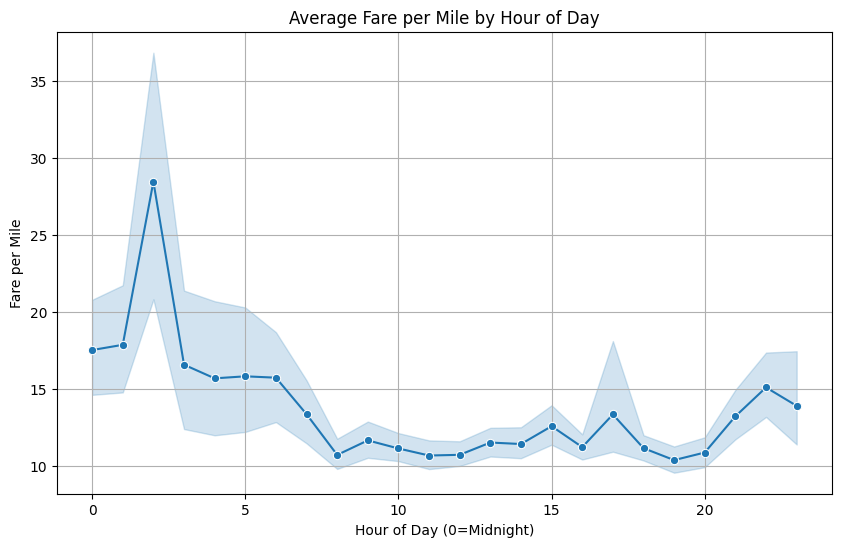

In [34]:
plt.figure(figsize=(10,6))
sns.lineplot(x='start_hour', y='Fare_per_mile', data=df, marker='o')
plt.title("Average Fare per Mile by Hour of Day")
plt.xlabel("Hour of Day (0=Midnight)")
plt.ylabel("Fare per Mile")
plt.grid(True)
plt.show()

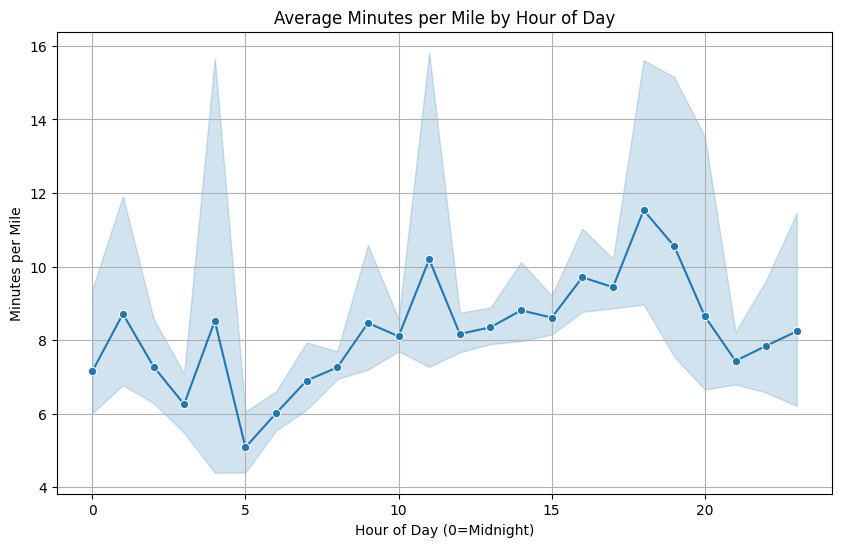

In [35]:
plt.figure(figsize=(10,6))
sns.lineplot(x='start_hour', y='minutes_per_mile', data=df, marker='o')
plt.title("Average Minutes per Mile by Hour of Day")
plt.xlabel("Hour of Day (0=Midnight)")
plt.ylabel("Minutes per Mile")
plt.grid(True)
plt.show()

In [36]:
df[['Trip Miles','Tips']].corr()

,Trip Miles,Tips
Trip Miles,1.00000,0.38511
Tips,0.38511,1.00000


In [37]:
df[['Trip Seconds','Tips']].corr()


,Trip Seconds,Tips
Trip Seconds,1.000000,0.173845
Tips,0.173845,1.000000


Text(0.5, 1.0, 'Miles vs Tips comparison')

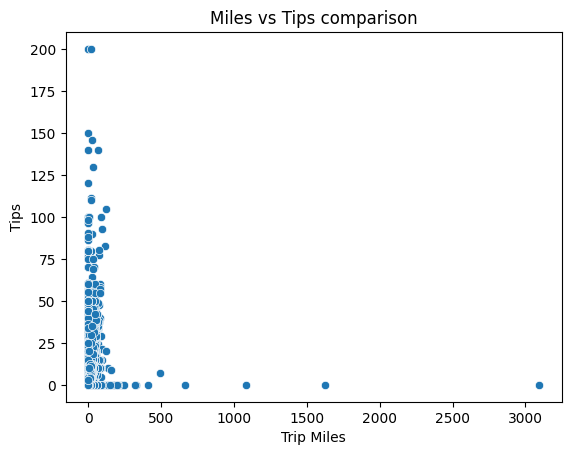

In [38]:
sns.scatterplot(x='Trip Miles',y='Tips',data=df)
plt.title("Miles vs Tips comparison")

C:\Users\Ps_TecH\AppData\Local\Temp\ipykernel_22952\2361782583.py:2: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Text(0.5, 1.0, 'Average Tips by Trip Distance Range')

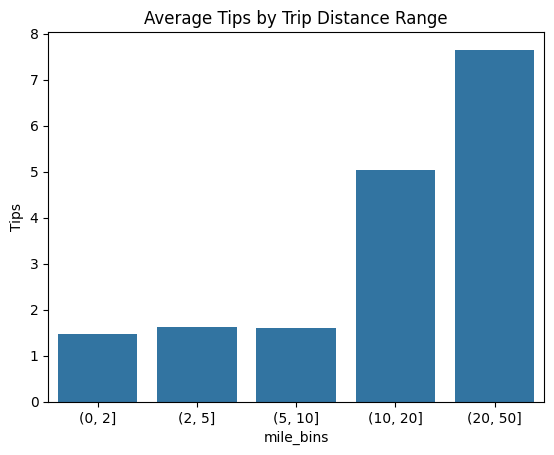

In [39]:
df['mile_bins'] = pd.cut(df['Trip Miles'], bins=[0,2,5,10,20,50])
avg_tips = df.groupby('mile_bins')['Tips'].mean().reset_index()

sns.barplot(x='mile_bins', y='Tips', data=avg_tips)
plt.title("Average Tips by Trip Distance Range")


C:\Users\Ps_TecH\AppData\Local\Temp\ipykernel_22952\3919821644.py:2: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Text(0.5, 1.0, 'Average Tips by Trip Time Range')

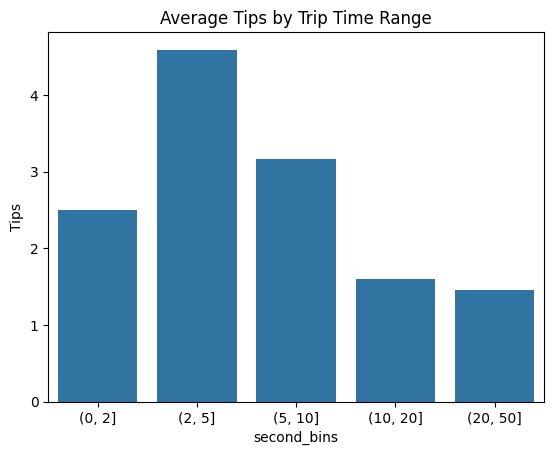

In [40]:
df['second_bins'] = pd.cut(df['Trip Seconds'], bins=[0,2,5,10,20,50])
avg_tips = df.groupby('second_bins')['Tips'].mean().reset_index()

sns.barplot(x='second_bins', y='Tips', data=avg_tips)
plt.title("Average Tips by Trip Time Range")


In [41]:
com_fare=df.groupby('Company')['Fare'].mean().reset_index()

Text(0.5, 1.0, 'Top 5 Companies by Average Fare')

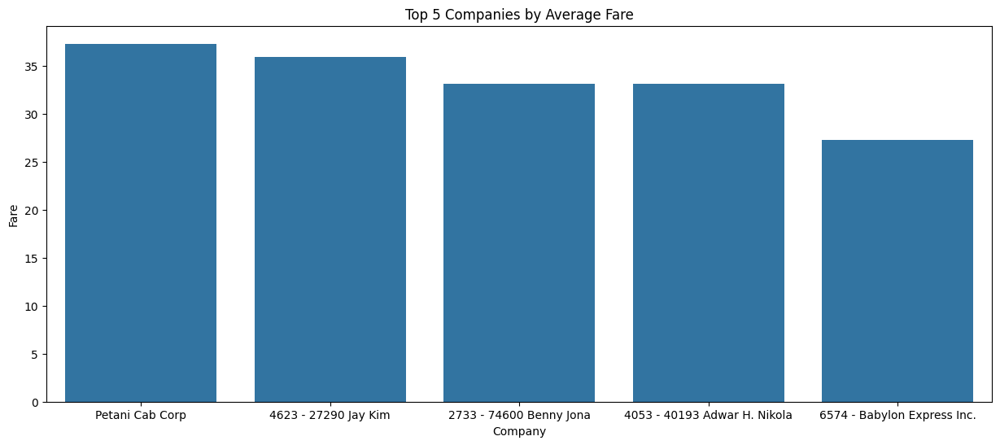

In [42]:
top5 = com_fare.sort_values(by='Fare', ascending=False).head(5)
plt.figure(figsize=(15,6))
sns.barplot(x='Company',y='Fare',data=top5)
plt.title("Top 5 Companies by Average Fare")


Text(0.5, 1.0, 'Bottom 5 Companies by Average Fare')

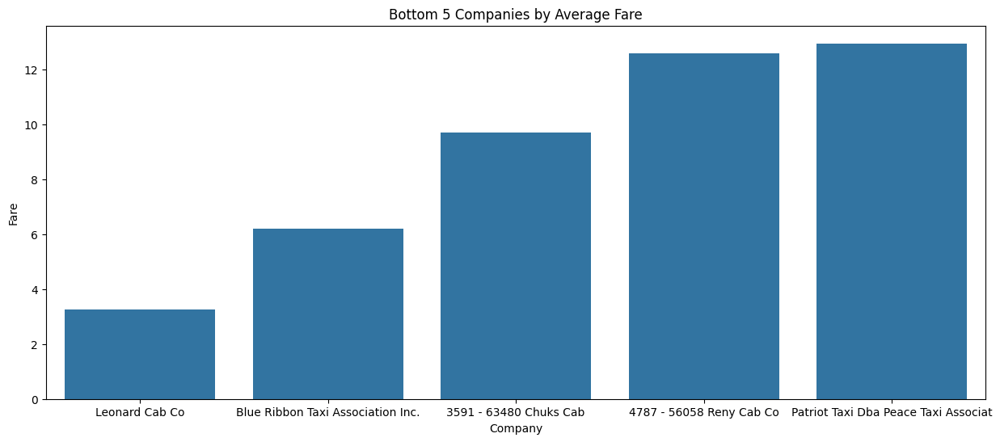

In [43]:
Bottom5 = com_fare.sort_values(by='Fare', ascending=True).head(5)
plt.figure(figsize=(15,6))
sns.barplot(x='Company',y='Fare',data=Bottom5)
plt.title("Bottom 5 Companies by Average Fare")


In [44]:
df_num = df.select_dtypes(include=['number'])


<Axes: >

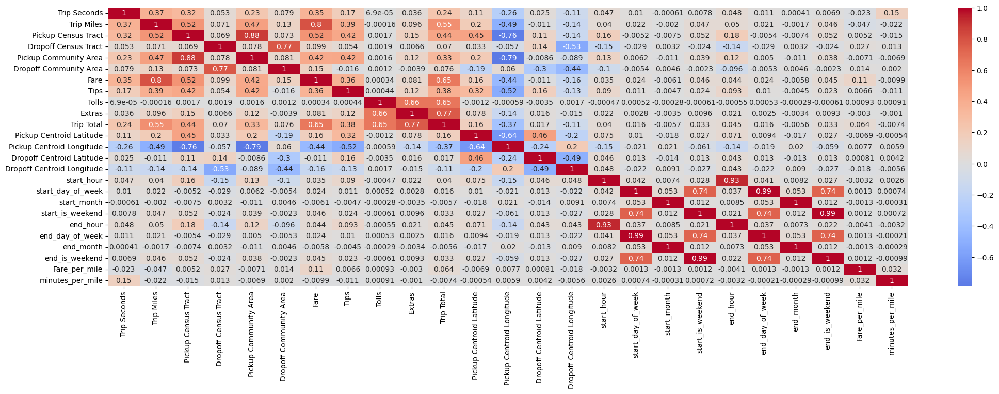

In [45]:
plt.figure(figsize=(25,7))
sns.heatmap(df_num.corr(),annot=True,cmap='coolwarm',center=0)

In [46]:
df['hour_sin'] = np.sin(2 * np.pi * df['start_hour']/24)
df['hour_cos'] = np.cos(2 * np.pi * df['start_hour']/24)


<Axes: ylabel='Fare'>

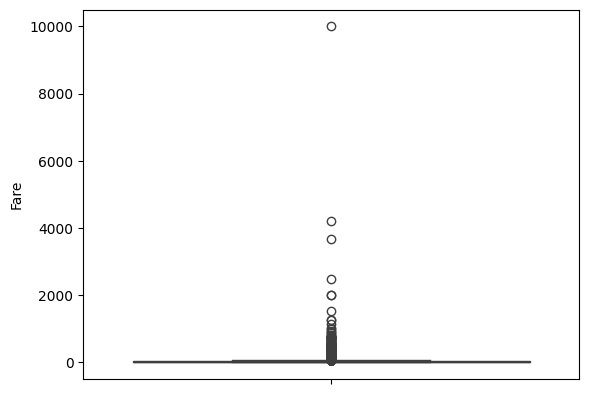

In [47]:
data=df['Fare']
sns.boxplot(data=data)

<Axes: ylabel='Trip Miles'>

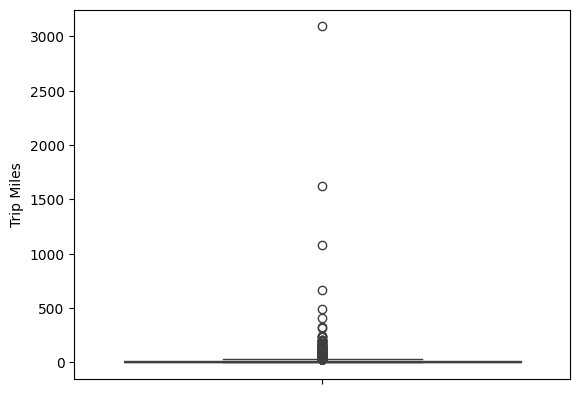

In [48]:
data=df['Trip Miles']
sns.boxplot(data=data)
# plt.ylim(0, 2000)   # y-axis limited
# plt.show()

<Axes: ylabel='Trip Seconds'>

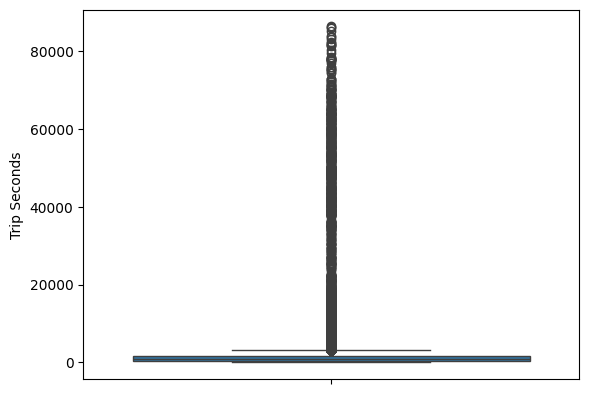

In [49]:
data=df['Trip Seconds']
sns.boxplot(data=data)
# plt.ylim(0, 5000)   # y-axis limited
# plt.show()

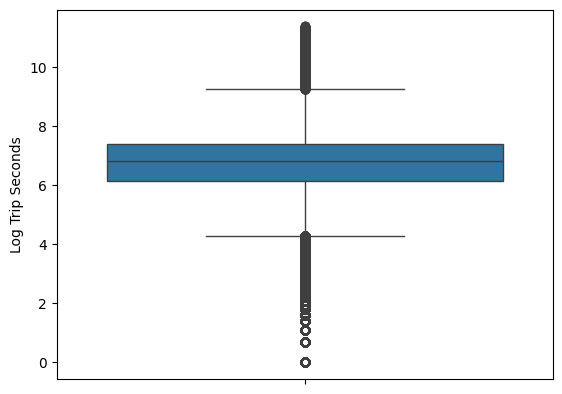

In [50]:
sns.boxplot(data=np.log1p(df["Trip Seconds"]))  # log(1+x) to handle 0
plt.ylabel("Log Trip Seconds")
plt.show()


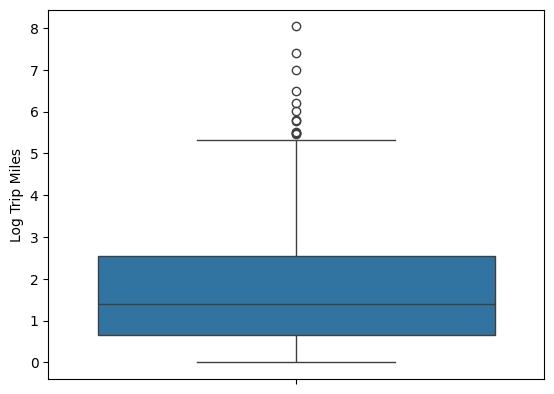

In [51]:
sns.boxplot(data=np.log1p(df["Trip Miles"]))  # log(1+x) to handle 0
plt.ylabel("Log Trip Miles")
plt.show()


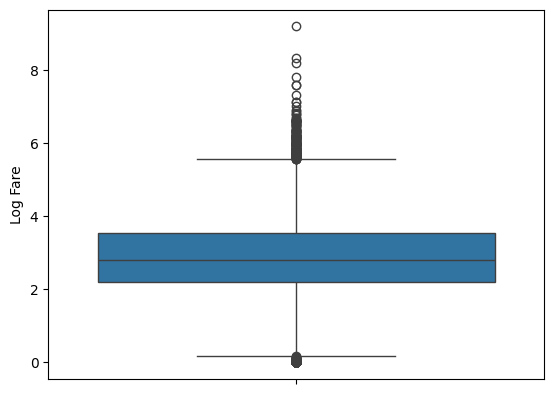

In [52]:
sns.boxplot(data=np.log1p(df["Fare"]))  # log(1+x) to handle 0
plt.ylabel("Log Fare")
plt.show()


(0.0, 8000.0)

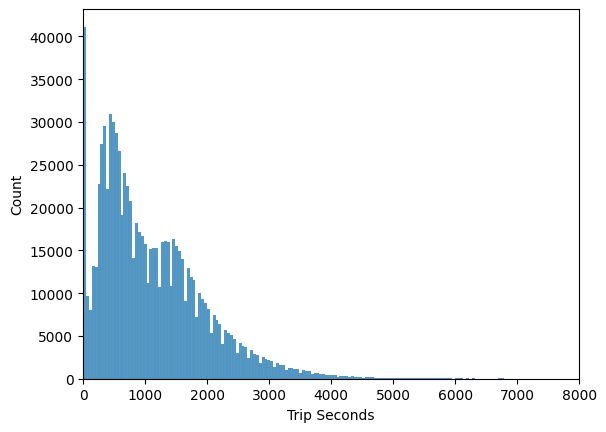

In [53]:
data=df['Trip Seconds']
sns.histplot(data=data)
plt.xlim(0,8000)

(0.0, 400.0)

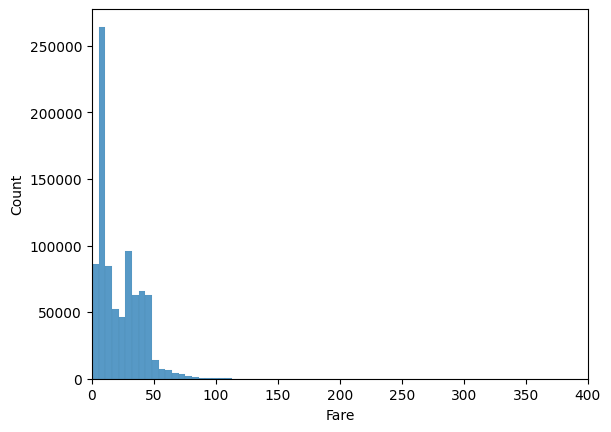

In [54]:
data=df['Fare']
sns.histplot(data=data)
plt.xlim(0,400)

(0.0, 100.0)

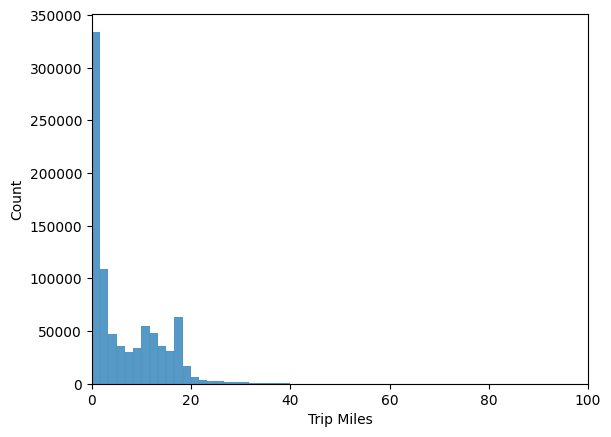

In [55]:
data=df['Trip Miles']
sns.histplot(data=data)
plt.xlim(0,100)

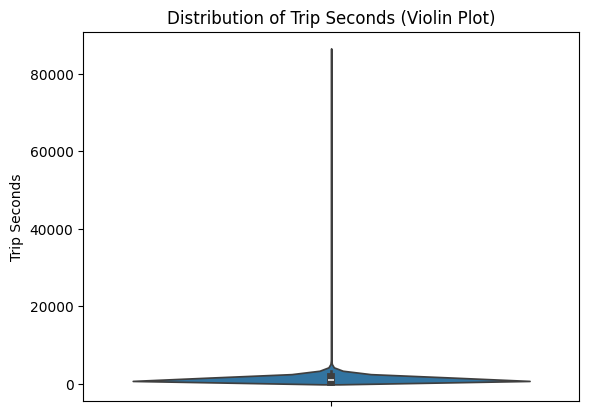

In [56]:
sns.violinplot(y=df["Trip Seconds"])
plt.title("Distribution of Trip Seconds (Violin Plot)")
plt.show()

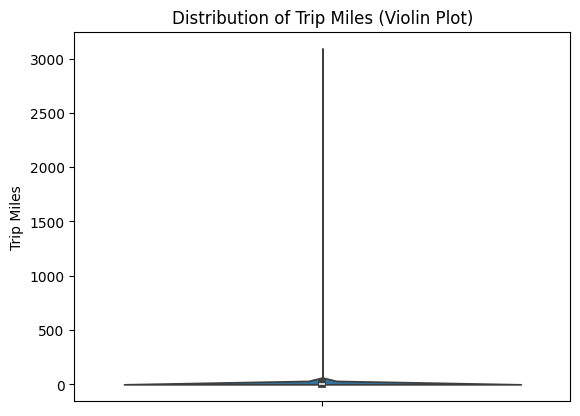

In [57]:
sns.violinplot(y=df["Trip Miles"])
plt.title("Distribution of Trip Miles (Violin Plot)")
plt.show()

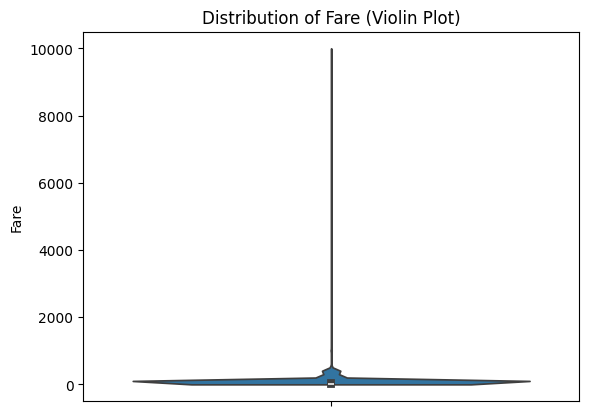

In [58]:
sns.violinplot(y=df["Fare"])
plt.title("Distribution of Fare (Violin Plot)")
plt.show()

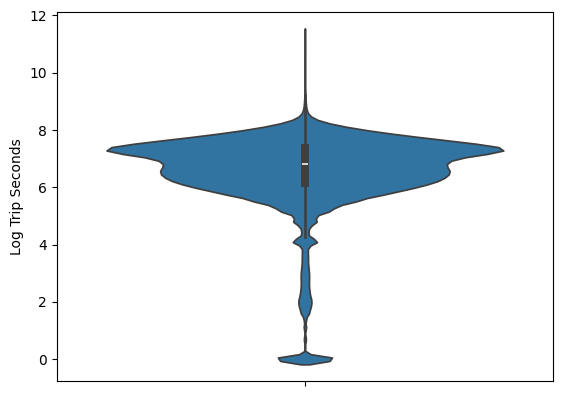

In [59]:
import numpy as np

sns.violinplot(y=np.log1p(df["Trip Seconds"]))  # log(1+x) to handle 0 safely
plt.ylabel("Log Trip Seconds")
plt.show()


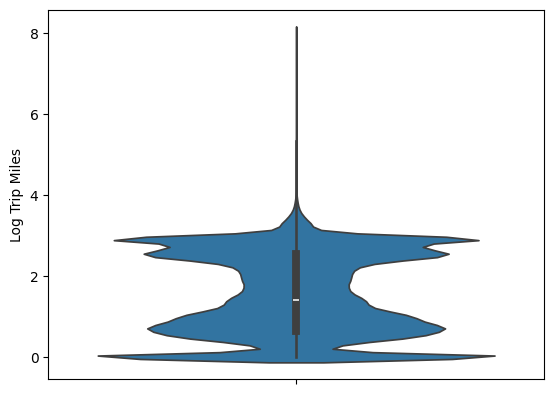

In [60]:
import numpy as np

sns.violinplot(y=np.log1p(df["Trip Miles"]))  # log(1+x) to handle 0 safely
plt.ylabel("Log Trip Miles")
plt.show()


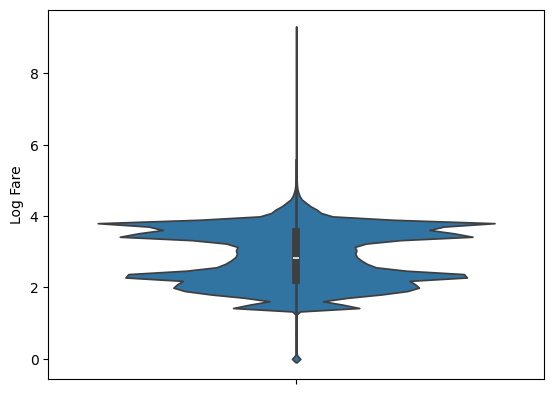

In [61]:
import numpy as np

sns.violinplot(y=np.log1p(df["Fare"]))  # log(1+x) to handle 0 safely
plt.ylabel("Log Fare")
plt.show()


In [64]:
df.head()

,Trip ID,Taxi ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,...,end_hour,end_day_of_week,end_month,end_is_weekend,Fare_per_mile,minutes_per_mile,mile_bins,second_bins,hour_sin,hour_cos
0,0287f53fedcde6b0af9aab9e32cbd2cadb337eaa,e54db25f18193a08f1f5754515e8c338480e04fb938ed3...,2024-03-01,2024-03-01 00:00:00,15.0,0.09,NaN,NaN,8.0,8.0,...,0.0,4.0,3.0,0,36.111111,2.777778,"(0, 2]","(10.0, 20.0]",0.0,1.0
1,1f0034299b914fd7b45002568576a353c83acb2f,4a263f78f56815be4acd38658af8fc1824ce4e15f7ec81...,2024-03-01,2024-03-01 00:15:00,900.0,3.00,NaN,NaN,24.0,8.0,...,0.0,4.0,3.0,0,4.000000,5.000000,"(2, 5]",NaN,0.0,1.0
2,01a0b77b722a0b91f45cb4fc90b3e64f76fd0681,4f1e94982e6851725add382f7981d64006ae7c38f3664f...,2024-03-01,2024-03-01 00:00:00,711.0,5.84,NaN,NaN,56.0,NaN,...,0.0,4.0,3.0,0,2.868151,2.029110,"(5, 10]",NaN,0.0,1.0
3,14aff2071ac81c6450a8f8b0e1534497da900197,de8e8659ceb9eb0da842a46b60c0a5207098ac69fc23ab...,2024-03-01,2024-03-01 00:30:00,1770.0,13.36,NaN,NaN,76.0,3.0,...,0.0,4.0,3.0,0,2.601048,2.208084,"(10, 20]",NaN,0.0,1.0
4,16d3a633e2f380cee4a7fa4677db163b6e91255d,d79d3e19a1d5f6cb0cd4449d5579412262a2f1b182799d...,2024-03-01,2024-03-01 00:15:00,849.0,6.13,NaN,NaN,8.0,3.0,...,0.0,4.0,3.0,0,3.019576,2.308320,"(5, 10]",NaN,0.0,1.0


In [65]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 863104 entries, 0 to 865246
Data columns (total 37 columns):
 #   Column                      Non-Null Count   Dtype         
---  ------                      --------------   -----         
 0   Trip ID                     863104 non-null  object        
 1   Taxi ID                     863103 non-null  object        
 2   Trip Start Timestamp        863104 non-null  datetime64[ns]
 3   Trip End Timestamp          863104 non-null  datetime64[ns]
 4   Trip Seconds                863104 non-null  float64       
 5   Trip Miles                  863104 non-null  float64       
 6   Pickup Census Tract         326058 non-null  float64       
 7   Dropoff Census Tract        312719 non-null  float64       
 8   Pickup Community Area       839952 non-null  float64       
 9   Dropoff Community Area      779486 non-null  float64       
 10  Fare                        863104 non-null  float64       
 11  Tips                        863104 non-null 

Text(0.5, 1.0, 'Distribution of fare')

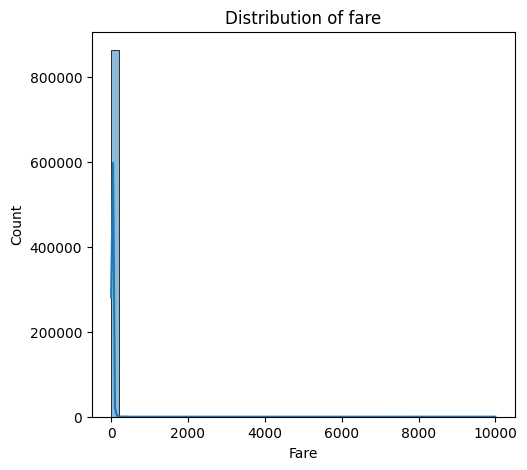

In [82]:
plt.figure(figsize=(12,5))

# Original distribution
plt.subplot(1,2,1)
sns.histplot(df['Fare'], bins=50, kde=True)
plt.title(f'Distribution of fare')


Text(0.5, 1.0, 'KDE of fare')

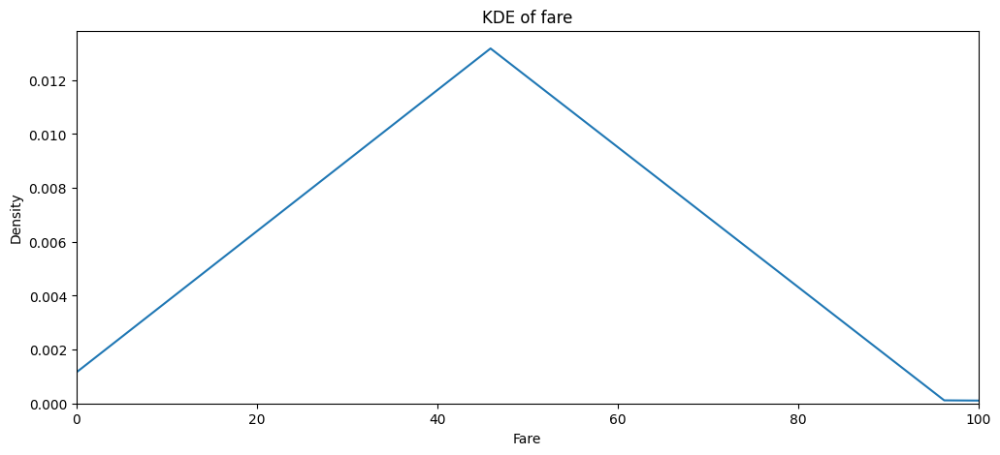

In [80]:
plt.figure(figsize=(12,5))

# Original distribution (KDE only)

plt.xlim(0, 100)   # only show values between 0 and 1000


sns.kdeplot(df['Fare'], fill=False)   # set fill=True if you want shaded area
plt.title(f'KDE of fare')


In [72]:
df[df['Fare']<=500].info()

<class 'pandas.core.frame.DataFrame'>
Index: 863054 entries, 0 to 865246
Data columns (total 37 columns):
 #   Column                      Non-Null Count   Dtype         
---  ------                      --------------   -----         
 0   Trip ID                     863054 non-null  object        
 1   Taxi ID                     863053 non-null  object        
 2   Trip Start Timestamp        863054 non-null  datetime64[ns]
 3   Trip End Timestamp          863054 non-null  datetime64[ns]
 4   Trip Seconds                863054 non-null  float64       
 5   Trip Miles                  863054 non-null  float64       
 6   Pickup Census Tract         326047 non-null  float64       
 7   Dropoff Census Tract        312713 non-null  float64       
 8   Pickup Community Area       839924 non-null  float64       
 9   Dropoff Community Area      779470 non-null  float64       
 10  Fare                        863054 non-null  float64       
 11  Tips                        863054 non-null 

Text(0.5, 1.0, 'KDE of Trip seconds')

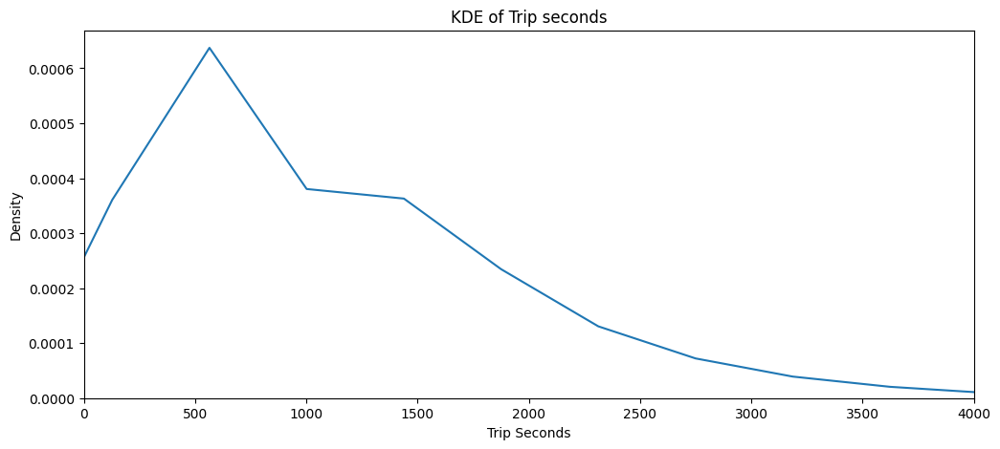

In [87]:
plt.figure(figsize=(12,5))

# Original distribution (KDE only)

plt.xlim(0, 4000)   # only show values between 0 and 1000


sns.kdeplot(df['Trip Seconds'], fill=False)   # set fill=True if you want shaded area
plt.title(f'KDE of Trip seconds')


Text(0.5, 1.0, 'KDE of Trip miles')

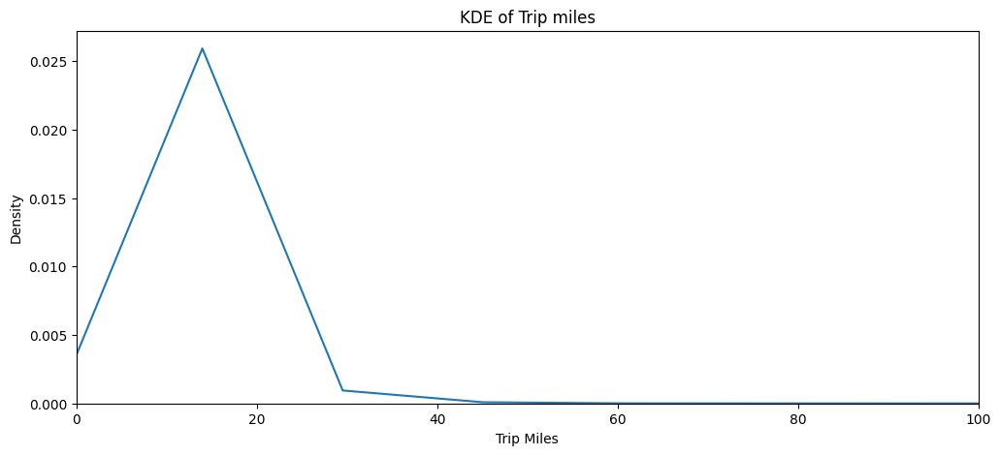

In [90]:
plt.figure(figsize=(12,5))

# Original distribution (KDE only)

plt.xlim(0, 100)   # only show values between 0 and 1000


sns.kdeplot(df['Trip Miles'], fill=False)   # set fill=True if you want shaded area
plt.title(f'KDE of Trip miles')


In [99]:
import numpy as np

mean = df['Fare'].mean()
std = df['Fare'].std()

z_scores = (df['Fare'] - mean) / std
outliers = df[np.abs(z_scores) > 3]
outliers.head()


,Trip ID,Taxi ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,...,end_hour,end_day_of_week,end_month,end_is_weekend,Fare_per_mile,minutes_per_mile,mile_bins,second_bins,hour_sin,hour_cos
554,d128aa2b8c63a02991e91f97423cbd8fd9974ff8,1d68f4a1c3b620f920838643bf3801e757b6791f86700a...,2024-02-29 22:45:00,2024-03-01 00:30:00,6507.0,29.25,NaN,NaN,NaN,76.0,...,0.0,4.0,3.0,0,3.230769,3.707692,"(20.0, 50.0]",NaN,-0.5,0.866025
735,568974ee3e7400ac0ec8d2df67a1e37055bbbb0f,fea1ad3b44e1a049eb5b1f33d9c53ddd6cae02b095b6a1...,2024-02-29 22:30:00,2024-02-29 22:30:00,0.0,0.00,NaN,NaN,NaN,NaN,...,22.0,3.0,2.0,0,inf,NaN,NaN,NaN,-0.5,0.866025
906,012d99cea6bc5419c584d9bd2be3784844f06267,5cffb97a6fd517bd5bc14f2d55ded4698066eb285e8c02...,2024-02-29 22:15:00,2024-02-29 22:15:00,12.0,0.00,NaN,NaN,6.0,6.0,...,22.0,3.0,2.0,0,inf,inf,NaN,"(10.0, 20.0]",-0.5,0.866025
995,a3712cbfdf7cb8db3a36a4835aa2f45dfe834225,5732bb53e9becb096e11b52228bb5079a585622bd15b74...,2024-02-29 22:00:00,2024-02-29 23:00:00,3600.0,44.90,1.703198e+10,NaN,56.0,NaN,...,23.0,3.0,2.0,0,2.344098,1.336303,"(20.0, 50.0]",NaN,-0.5,0.866025
1035,b0cc0e5dac9b9f9ef4d7d6de1dab8c8258db6d8a,e168baf6e4ae34f44dd0fe4181d53ced50df8150c08c85...,2024-02-29 22:00:00,2024-02-29 22:45:00,2407.0,32.35,1.703198e+10,NaN,76.0,NaN,...,22.0,3.0,2.0,0,4.358578,1.240082,"(20.0, 50.0]",NaN,-0.5,0.866025


In [98]:
Q1 = df['Fare'].quantile(0.25)
Q3 = df['Fare'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

outliers = df[(df['Fare'] < lower_bound) | (df['Fare'] > upper_bound)]
outliers.head()



,Trip ID,Taxi ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,...,end_hour,end_day_of_week,end_month,end_is_weekend,Fare_per_mile,minutes_per_mile,mile_bins,second_bins,hour_sin,hour_cos
5,07a1e0cf2a3e0def140837ebda3d4f1befd3a4fd,00aeef49089b36ed668920fac1119a26fb25d1b48102a4...,2024-03-01 00:00:00,2024-03-01 00:30:00,2280.0,2.00,1.703198e+10,NaN,76.0,NaN,...,0.0,4.0,3.0,0,38.750000,19.000000,"(0.0, 2.0]",NaN,0.000000,1.000000
357,237d45e5c8ef8da3a6e4b0fd3c85fa8f30256d22,d2e7412183332088cd57ff24413111d9e80428f27c127a...,2024-02-29 23:00:00,2024-02-29 23:45:00,2640.0,33.50,1.703198e+10,NaN,76.0,NaN,...,23.0,3.0,2.0,0,2.373134,1.313433,"(20.0, 50.0]",NaN,-0.258819,0.965926
536,ac9458abe81db9541f7ee755a2df0c464971f97a,2c2846e06a06b51bf72e041bce82b95d5471941476ff25...,2024-02-29 22:45:00,2024-02-29 22:45:00,5.0,0.00,NaN,NaN,8.0,8.0,...,22.0,3.0,2.0,0,inf,inf,NaN,"(2.0, 5.0]",-0.500000,0.866025
554,d128aa2b8c63a02991e91f97423cbd8fd9974ff8,1d68f4a1c3b620f920838643bf3801e757b6791f86700a...,2024-02-29 22:45:00,2024-03-01 00:30:00,6507.0,29.25,NaN,NaN,NaN,76.0,...,0.0,4.0,3.0,0,3.230769,3.707692,"(20.0, 50.0]",NaN,-0.500000,0.866025
735,568974ee3e7400ac0ec8d2df67a1e37055bbbb0f,fea1ad3b44e1a049eb5b1f33d9c53ddd6cae02b095b6a1...,2024-02-29 22:30:00,2024-02-29 22:30:00,0.0,0.00,NaN,NaN,NaN,NaN,...,22.0,3.0,2.0,0,inf,NaN,NaN,NaN,-0.500000,0.866025


In [97]:
Q1 = df['Trip Seconds'].quantile(0.25)
Q3 = df['Trip Seconds'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

outliers = df[(df['Trip Seconds'] < lower_bound) | (df['Trip Seconds'] > upper_bound)]
outliers.head()



,Trip ID,Taxi ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,...,end_hour,end_day_of_week,end_month,end_is_weekend,Fare_per_mile,minutes_per_mile,mile_bins,second_bins,hour_sin,hour_cos
151,0834517705cc61e37fcef5a42b4f170ce71c388f,ee4f6cc4f34fd53727da7a1cf6fa1f33a4d4f02b4fd085...,2024-02-29 23:30:00,2024-03-01 11:30:00,43171.0,40.35,NaN,NaN,24.0,76.0,...,11.0,4.0,3.0,0,0.000248,17.831888,"(20.0, 50.0]",NaN,-0.258819,0.965926
203,f93204e41cbcca68d11ce2c7080d5c978afa40ea,f3af8002f02eb5eea68aa4cba00200f124550bb4759054...,2024-02-29 23:30:00,2024-03-01 00:30:00,3366.0,16.04,NaN,NaN,56.0,6.0,...,0.0,4.0,3.0,0,2.914589,3.497506,"(10.0, 20.0]",NaN,-0.258819,0.965926
353,1cb5a6390df38334dc4c9768e02d88f7dc00118d,d6e1a9e103336c396201abe9ceb00795fcd41e14ccbf54...,2024-02-29 23:15:00,2024-03-01 14:30:00,54939.0,0.00,NaN,NaN,24.0,16.0,...,14.0,4.0,3.0,0,inf,inf,NaN,NaN,-0.258819,0.965926
389,e32fad791dbb67d1dd1c596dc7380971bceebf9f,ba00e9e869bec19b8a1fda607747c69673802b3a468e20...,2024-02-29 23:00:00,2024-03-01 07:30:00,30664.0,1.10,NaN,NaN,76.0,17.0,...,7.0,4.0,3.0,0,5.227273,464.606061,"(0.0, 2.0]",NaN,-0.258819,0.965926
554,d128aa2b8c63a02991e91f97423cbd8fd9974ff8,1d68f4a1c3b620f920838643bf3801e757b6791f86700a...,2024-02-29 22:45:00,2024-03-01 00:30:00,6507.0,29.25,NaN,NaN,NaN,76.0,...,0.0,4.0,3.0,0,3.230769,3.707692,"(20.0, 50.0]",NaN,-0.500000,0.866025


In [96]:
Q1 = df['Trip Miles'].quantile(0.25)
Q3 = df['Trip Miles'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

outliers = df[(df['Trip Miles'] < lower_bound) | (df['Trip Miles'] > upper_bound)]
outliers.head()


,Trip ID,Taxi ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,...,end_hour,end_day_of_week,end_month,end_is_weekend,Fare_per_mile,minutes_per_mile,mile_bins,second_bins,hour_sin,hour_cos
151,0834517705cc61e37fcef5a42b4f170ce71c388f,ee4f6cc4f34fd53727da7a1cf6fa1f33a4d4f02b4fd085...,2024-02-29 23:30:00,2024-03-01 11:30:00,43171.0,40.35,NaN,NaN,24.0,76.0,...,11.0,4.0,3.0,0,0.000248,17.831888,"(20, 50]",NaN,-0.258819,0.965926
160,13cd322d2fcfb35a20d95f6d4fd885aee4415f97,ea67cf50724b1bb2aefc695753c9640903e27d2ea46cd8...,2024-02-29 23:30:00,2024-03-01 00:00:00,1920.0,32.40,1.703198e+10,NaN,76.0,NaN,...,0.0,4.0,3.0,0,1.929012,0.987654,"(20, 50]",NaN,-0.258819,0.965926
357,237d45e5c8ef8da3a6e4b0fd3c85fa8f30256d22,d2e7412183332088cd57ff24413111d9e80428f27c127a...,2024-02-29 23:00:00,2024-02-29 23:45:00,2640.0,33.50,1.703198e+10,NaN,76.0,NaN,...,23.0,3.0,2.0,0,2.373134,1.313433,"(20, 50]",NaN,-0.258819,0.965926
554,d128aa2b8c63a02991e91f97423cbd8fd9974ff8,1d68f4a1c3b620f920838643bf3801e757b6791f86700a...,2024-02-29 22:45:00,2024-03-01 00:30:00,6507.0,29.25,NaN,NaN,NaN,76.0,...,0.0,4.0,3.0,0,3.230769,3.707692,"(20, 50]",NaN,-0.500000,0.866025
669,ff1ceceb52e33056a5da4c52f5d88d02bdd27266,da3e1a4ae3869a45b431284672484905a694d6a7a08a05...,2024-02-29 22:30:00,2024-02-29 23:00:00,1951.0,28.66,1.703198e+10,NaN,76.0,NaN,...,23.0,3.0,2.0,0,2.390091,1.134566,"(20, 50]",NaN,-0.500000,0.866025


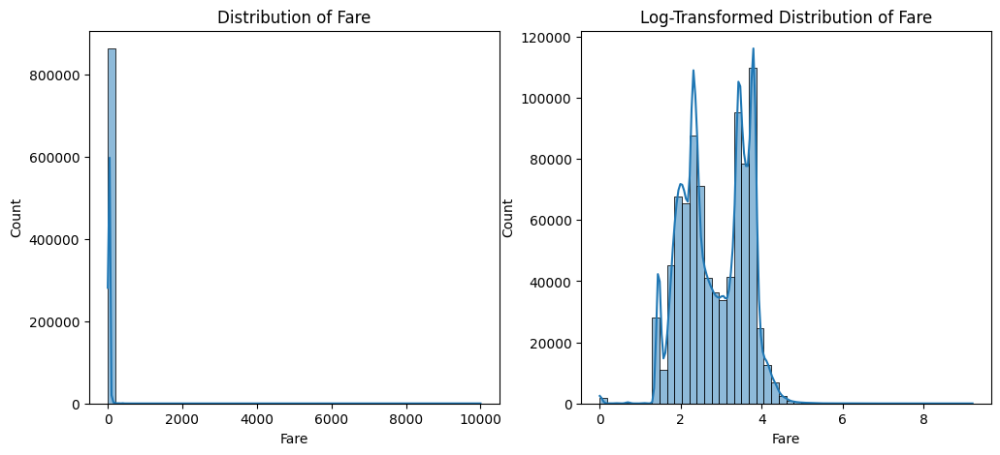

In [100]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# pick one numeric column first
col = 'Fare'   # change to your column name

plt.figure(figsize=(12,5))

# Original distribution
plt.subplot(1,2,1)
sns.histplot(df[col], bins=50, kde=True)
plt.title(f'Distribution of {col}')

# Log-transformed distribution (log1p handles zeros safely)
plt.subplot(1,2,2)
sns.histplot(np.log1p(df[col]), bins=50, kde=True)
plt.title(f'Log-Transformed Distribution of {col}')

plt.show()


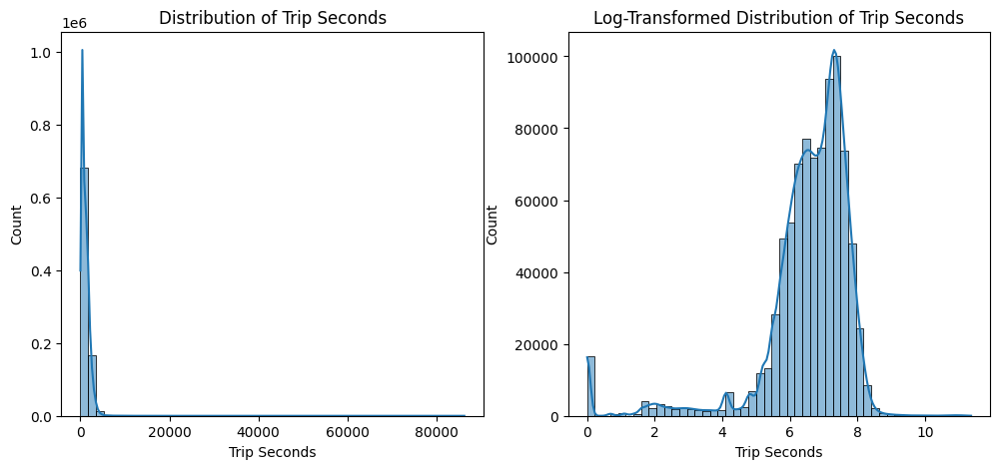

In [102]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# pick one numeric column first
col = 'Trip Seconds'   # change to your column name

plt.figure(figsize=(12,5))

# Original distribution
plt.subplot(1,2,1)
sns.histplot(df[col], bins=50, kde=True)
plt.title(f'Distribution of {col}')

# Log-transformed distribution (log1p handles zeros safely)
plt.subplot(1,2,2)
sns.histplot(np.log1p(df[col]), bins=50, kde=True)
plt.title(f'Log-Transformed Distribution of {col}')

plt.show()


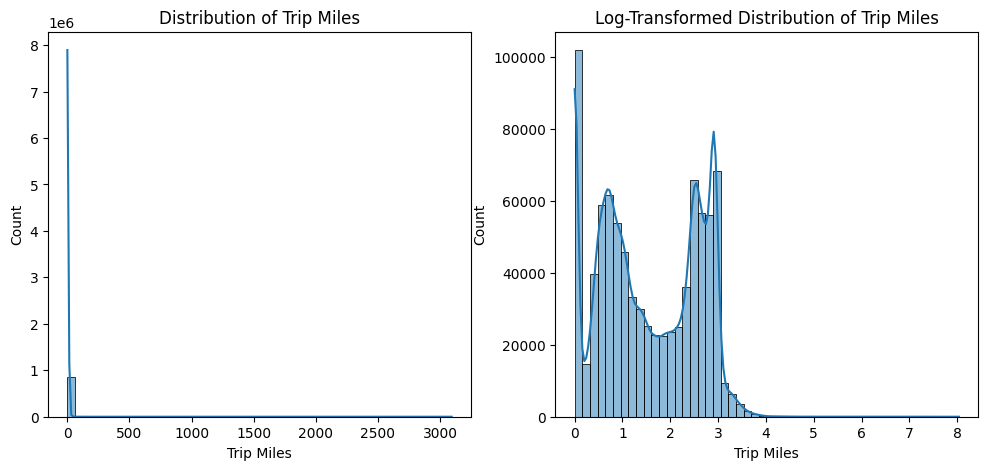

In [103]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# pick one numeric column first
col = 'Trip Miles'   # change to your column name

plt.figure(figsize=(12,5))

# Original distribution
plt.subplot(1,2,1)
sns.histplot(df[col], bins=50, kde=True)
plt.title(f'Distribution of {col}')

# Log-transformed distribution (log1p handles zeros safely)
plt.subplot(1,2,2)
sns.histplot(np.log1p(df[col]), bins=50, kde=True)
plt.title(f'Log-Transformed Distribution of {col}')

plt.show()


In [104]:
df.head()

,Trip ID,Taxi ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,...,end_hour,end_day_of_week,end_month,end_is_weekend,Fare_per_mile,minutes_per_mile,mile_bins,second_bins,hour_sin,hour_cos
0,0287f53fedcde6b0af9aab9e32cbd2cadb337eaa,e54db25f18193a08f1f5754515e8c338480e04fb938ed3...,2024-03-01,2024-03-01 00:00:00,15.0,0.09,NaN,NaN,8.0,8.0,...,0.0,4.0,3.0,0,36.111111,2.777778,"(0, 2]","(10.0, 20.0]",0.0,1.0
1,1f0034299b914fd7b45002568576a353c83acb2f,4a263f78f56815be4acd38658af8fc1824ce4e15f7ec81...,2024-03-01,2024-03-01 00:15:00,900.0,3.00,NaN,NaN,24.0,8.0,...,0.0,4.0,3.0,0,4.000000,5.000000,"(2, 5]",NaN,0.0,1.0
2,01a0b77b722a0b91f45cb4fc90b3e64f76fd0681,4f1e94982e6851725add382f7981d64006ae7c38f3664f...,2024-03-01,2024-03-01 00:00:00,711.0,5.84,NaN,NaN,56.0,NaN,...,0.0,4.0,3.0,0,2.868151,2.029110,"(5, 10]",NaN,0.0,1.0
3,14aff2071ac81c6450a8f8b0e1534497da900197,de8e8659ceb9eb0da842a46b60c0a5207098ac69fc23ab...,2024-03-01,2024-03-01 00:30:00,1770.0,13.36,NaN,NaN,76.0,3.0,...,0.0,4.0,3.0,0,2.601048,2.208084,"(10, 20]",NaN,0.0,1.0
4,16d3a633e2f380cee4a7fa4677db163b6e91255d,d79d3e19a1d5f6cb0cd4449d5579412262a2f1b182799d...,2024-03-01,2024-03-01 00:15:00,849.0,6.13,NaN,NaN,8.0,3.0,...,0.0,4.0,3.0,0,3.019576,2.308320,"(5, 10]",NaN,0.0,1.0


In [105]:
df.to_csv("taxitrip.csv",index=False)